In [1]:
import numpy as np 
import glob
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
%matplotlib inline

# Camera calibration

In [2]:
# First calibrate the camera
CALIBRATION_FOLDER_NAME = "camera_cal"

# read in the images
images_path = glob.glob(os.path.join(CALIBRATION_FOLDER_NAME, "calibration*.jpg"))
print(images_path) 

['camera_cal/calibration10.jpg', 'camera_cal/calibration11.jpg', 'camera_cal/calibration12.jpg', 'camera_cal/calibration13.jpg', 'camera_cal/calibration14.jpg', 'camera_cal/calibration15.jpg', 'camera_cal/calibration16.jpg', 'camera_cal/calibration17.jpg', 'camera_cal/calibration18.jpg', 'camera_cal/calibration19.jpg', 'camera_cal/calibration2.jpg', 'camera_cal/calibration20.jpg', 'camera_cal/calibration3.jpg', 'camera_cal/calibration4.jpg', 'camera_cal/calibration5.jpg', 'camera_cal/calibration6.jpg', 'camera_cal/calibration7.jpg', 'camera_cal/calibration8.jpg', 'camera_cal/calibration9.jpg']


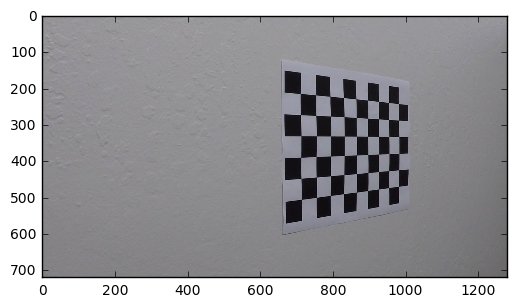

In [3]:
# Look at an image to see how many corners are in the chessboard 
test_image = mpimg.imread(images_path[np.random.randint(len(images_path))])
plt.imshow(test_image)

In [4]:
# Define the number of corners
nx = 9
ny = 6

# define the object points, these are the points that are on the chessboard
objp = np.zeros((ny * nx, 3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-2, 2) # x, y coordinates

In [5]:
# Now define the corners on the images
# The goal here is to map the imgpoints (which are the coordinates on the image) to our 
# predefined world coordinates

imgpoints = [] # these are the 3D points in the real world space
objpoints = [] # these are the 2D points in the image plane
chessboards_with_drawn_corners = []

for image_path in images_path:
    # if matplotlib is used
    image = mpimg.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    
    
    # if cv2 is used although we don't use it to plot as it can't plot inline
#     image = cv2.imread(image_path)
#     print(image)
#     break
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) # note that we use BGR2GRAY 
    
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp) 
        chessboard_with_drawn_corners = cv2.drawChessboardCorners(image, (nx, ny), corners, ret)
        chessboards_with_drawn_corners.append(chessboard_with_drawn_corners) 
        
#         cv2.imshow('img', chessboard_with_drawn_corners)
#         cv2.waitKey(500)

In [6]:
# Plot the first two corners from the image in the image's coordinates
print(imgpoints[0][0:2])

[[[ 545.32366943  343.10897827]]

 [[ 602.63201904  342.73617554]]]


In [7]:
# Plot the first two points in the real world space
print(objpoints[0][0:2])

[[ 0.  0.  0.]
 [ 1.  0.  0.]]


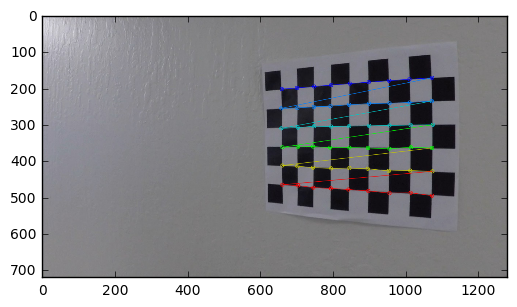

In [8]:
# Plot a sample image with the corners drawn on the chessboards
# cv2.imshow('chessboards_with_drawn_corners', chessboards_with_drawn_corners[np.random.randint(len(chessboards_with_drawn_corners))])
# cv2.waitKey(500)
plt.imshow(chessboards_with_drawn_corners[np.random.randint(len(chessboards_with_drawn_corners))])

In [9]:
# Finally calibrate the camera
test_image_path = os.path.join(CALIBRATION_FOLDER_NAME, "test_for_calibration.jpg")
test_image = plt.imread(test_image_path)
test_image_size = (test_image.shape[1], test_image.shape[0])
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, test_image_size, None, None)

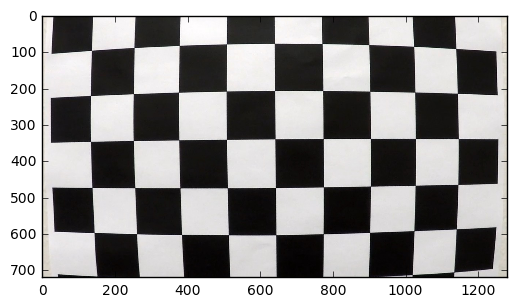

In [10]:
# Plot test image before applying undistorting
plt.imshow(test_image)

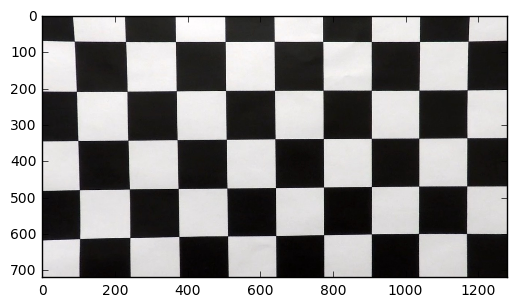

In [11]:
# Plot test image after applying undistortion
dest = cv2.undistort(test_image, mtx, dist, None, mtx)
plt.imshow(dest)

In [12]:
# Now lets aggregate these into a function

def calibrate_camera(calibration_image_paths, test_image_path, nx, ny):

    # define the object points, these are the points that are on the chessboard
    objp = np.zeros((ny * nx, 3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-2, 2) # x, y coordinates
    
    # define the image points, these are the points that are in the real world
    # The goal here is to map the imgpoints (which are the coordinates on the image) to our 
    # predefined world coordinates

    imgpoints = [] # these are the 3D points in the real world space
    objpoints = [] # these are the 2D points in the image plane
    chessboards_with_drawn_corners = []

    for image_path in calibration_image_paths:
        
        # if matplotlib is used
        image = mpimg.imread(image_path)
        gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)


        # if cv2 is used although we don't use it to plot as it can't plot inline
    #     image = cv2.imread(image_path)
    #     print(image)
    #     break
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) # note that we use BGR2GRAY 

        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

        if ret == True:
            imgpoints.append(corners)
            objpoints.append(objp) 
            chessboard_with_drawn_corners = cv2.drawChessboardCorners(image, (nx, ny), corners, ret)
            chessboards_with_drawn_corners.append(chessboard_with_drawn_corners)
        
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, test_image_size, None, None)
    return mtx, dist

In [13]:
# test it
CALIBRATION_FOLDER_NAME = "camera_cal"

# image paths for calibration images
calibration_image_paths = glob.glob(os.path.join(CALIBRATION_FOLDER_NAME, "calibration*.jpg"))

# image path for test image
test_image_path = os.path.join(CALIBRATION_FOLDER_NAME, "test_for_calibration.jpg")

# For the parameters for the calibration
mtx, dist = calibrate_camera(calibration_image_paths, test_image_path, 9, 6)

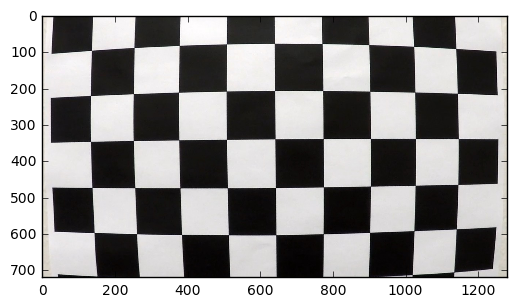

In [14]:
# plot the distorted image
test_image = mpimg.imread(test_image_path)
plt.imshow(test_image)

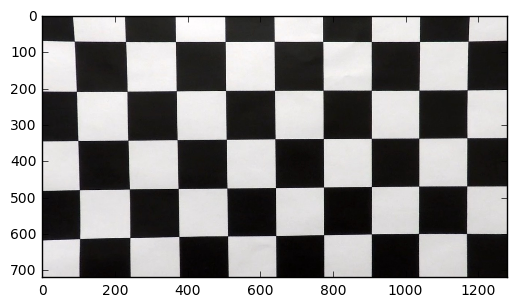

In [15]:
# plot the undistorted image
dest = cv2.undistort(test_image, mtx, dist, None, mtx)
plt.imshow(dest)

# Undistort lane image

In [16]:
# Read in the test images
LANE_LINES_FOLDER_NAME = "test_images"
lane_line_image_paths = glob.glob(os.path.join(LANE_LINES_FOLDER_NAME, '*.jpg'))
lane_line_images = [mpimg.imread(lane_line_image_path) for lane_line_image_path in lane_line_image_paths]

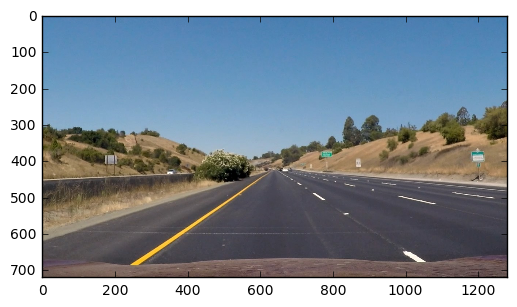

In [17]:
# Plot a sample image
sample_lane_image = lane_line_images[0]
plt.imshow(sample_lane_image)

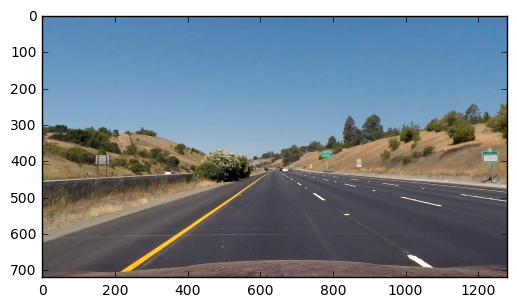

In [18]:
# Now undistort the image
dest = cv2.undistort(sample_lane_image, mtx, dist, None, mtx)
plt.imshow(dest)

# Use color transforms, gradients and other methods to create a thresholded binary image
First plot the images in different color channels to see which color is most useful in detecting lane lines

In [19]:
# Create an image wrapper class for easier conversion being color spaces
RGB_COLOR_SPACE = "RGB"
HLS_COLOR_SPACE = "HLS"
SINGLE_COLOR_CHANNEL = "Single"

In [20]:
from enum import Enum
class ColorSpace(Enum): 
    RGB = 1
    HLS = 2
    
class ImageWrapper:
    """
    This class is a wrapper class that allows for easier conversion between
    color spaces
    """
    def __init__(self, image, color_space):
        self.image = image
        self.width = image.shape[1]
        self.height = image.shape[0]
        self.color_space = color_space
        
    def _set_color_space(self, new_color_space):
        if self.color_space == new_color_space:
            pass
        else:
            if new_color_space == ColorSpace.RGB:
                self.image = cv2.cvtColor(self.image, cv2.COLOR_HLS2RGB)
                self.color_space = new_color_space
            elif new_color_space == ColorSpace.HLS:
                self.image = cv2.cvtColor(self.image, cv2.COLOR_RGB2HLS)
                self.color_space = new_color_space
             
    def get_RGB(self):
        self._set_color_space(ColorSpace.RGB)
        return(self.image)
    def get_R(self):
        self._set_color_space(ColorSpace.RGB)
        return(self.image[:,:,0])
    def get_G(self):
        self._set_color_space(ColorSpace.RGB)
        return(self.image[:,:,1])
    def get_B(self):
        self._set_color_space(ColorSpace.RGB)
        return(self.image[:,:,2])
   
    def get_HLS(self):
        self._set_color_space(ColorSpace.HLS)
        return(self.image)
    def get_H(self):
        self._set_color_space(ColorSpace.HLS)
        return(self.image[:,:,0])
    def get_L(self):
        self._set_color_space(ColorSpace.HLS)
        return(self.image[:,:,1])
    def get_S(self):
        self._set_color_space(ColorSpace.HLS)
        return(self.image[:,:,2]) 

In [21]:
from matplotlib.colors import hsv_to_rgb
# Define a function to plot the images in differen color spaces
# Plot the graph 
def plot_all_color_channels(image):
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3, figsize = (30, 15))
    f.tight_layout()
    wspace = 0.25   # the amount of width reserved for blank space between subplots
    hspace = 0.25   # the amount of height reserved for white space between subplots
    f.subplots_adjust(wspace = wspace, hspace = hspace)
    font = {'size' : 30}
    ax1.imshow(image.get_R(), cmap = 'gray')
    ax1.set_title("R", fontdict=font)
    ax2.imshow(image.get_G(), cmap = 'gray')
    ax2.set_title("G", fontdict=font)
    ax3.imshow(image.get_B(), cmap = 'gray')
    ax3.set_title("B", fontdict = font)
    ax4.imshow(image.get_H(), cmap = 'gray')
    ax4.set_title("H", fontdict = font)
    ax5.imshow(image.get_L(), cmap = 'gray')
    ax5.set_title("L", fontdict = font)
    ax6.imshow(image.get_S(), cmap = 'gray')
    ax6.set_title("S", fontdict = font)
    ax7.imshow(hsv_to_rgb(image.get_HLS()))
    ax7.set_title("HSV", fontdict = font)
    ax8.imshow(image.get_RGB())
    ax8.set_title("RGB", fontdict = font)
    ax9.set_title("None")

In [22]:
# Plot all the lane line images to see what combination of lane lines is better
wrapped_lane_line_images = [ImageWrapper(image, ColorSpace.RGB) for image in lane_line_images]

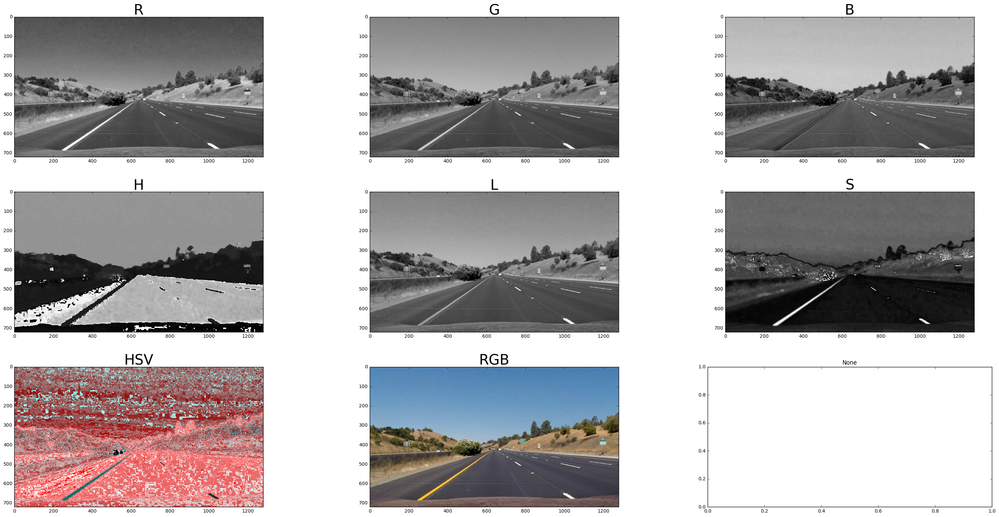

In [23]:
plot_all_color_channels(wrapped_lane_line_images[0])

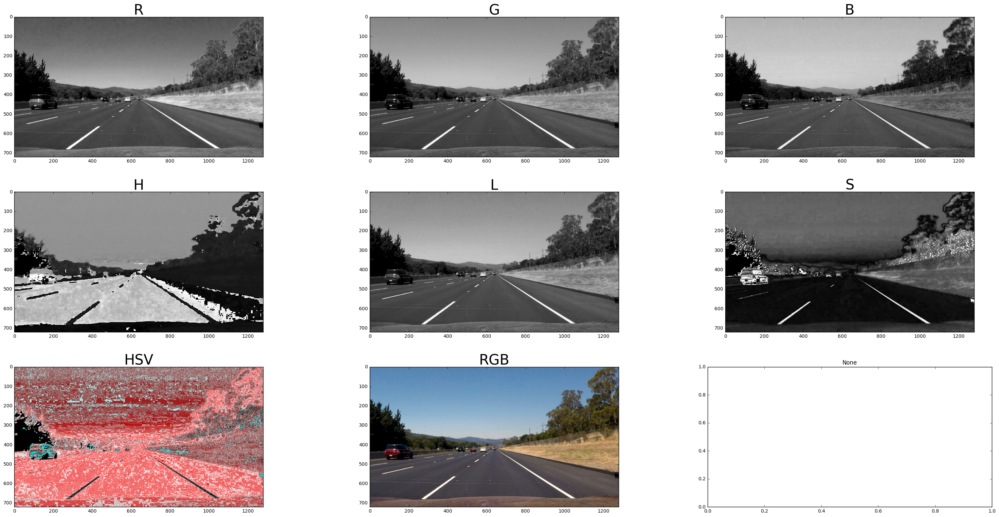

In [24]:
plot_all_color_channels(wrapped_lane_line_images[1])

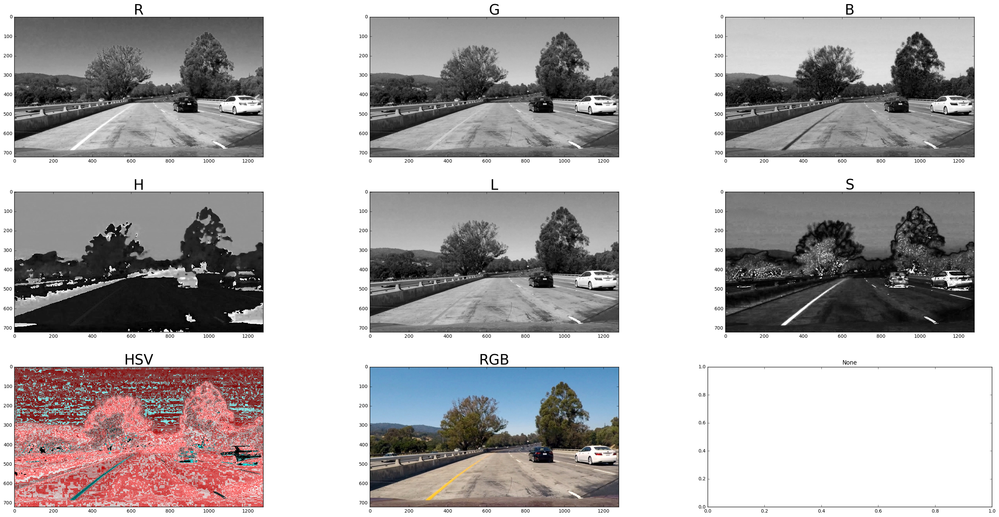

In [25]:
plot_all_color_channels(wrapped_lane_line_images[2])

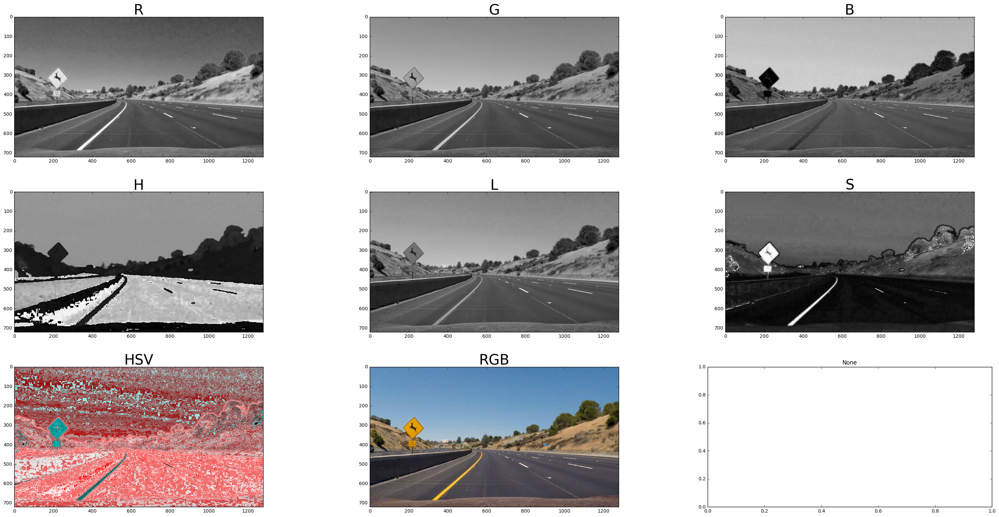

In [26]:
plot_all_color_channels(wrapped_lane_line_images[3])

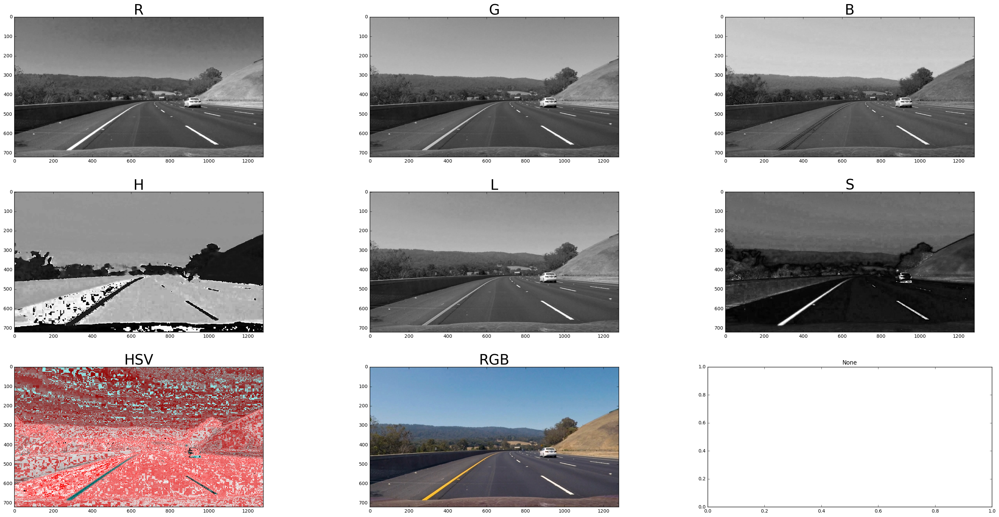

In [27]:
plot_all_color_channels(wrapped_lane_line_images[4])

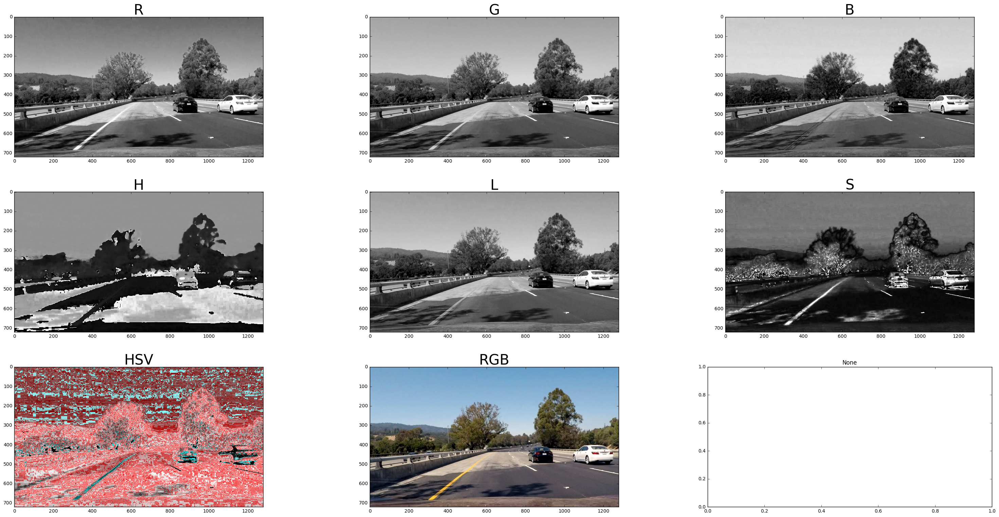

In [28]:
plot_all_color_channels(wrapped_lane_line_images[5])

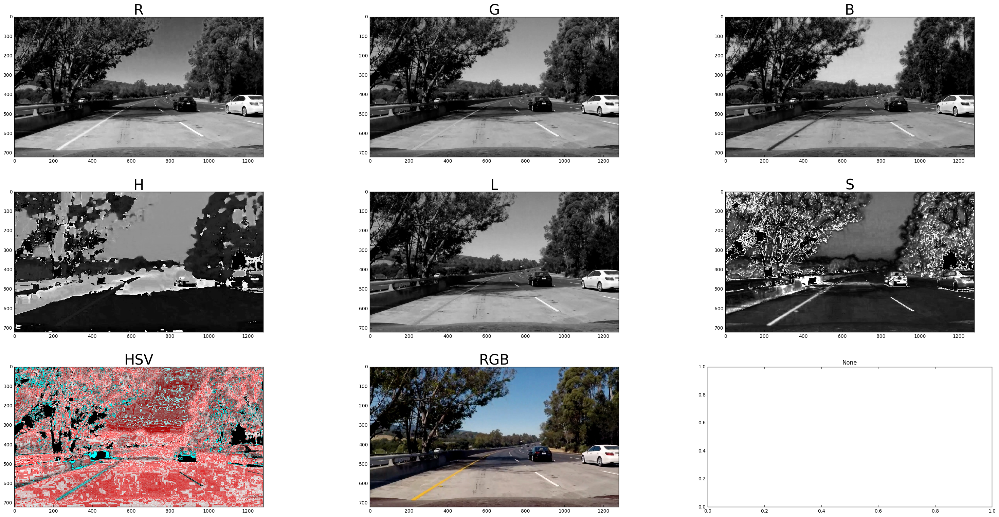

In [29]:
plot_all_color_channels(wrapped_lane_line_images[6])

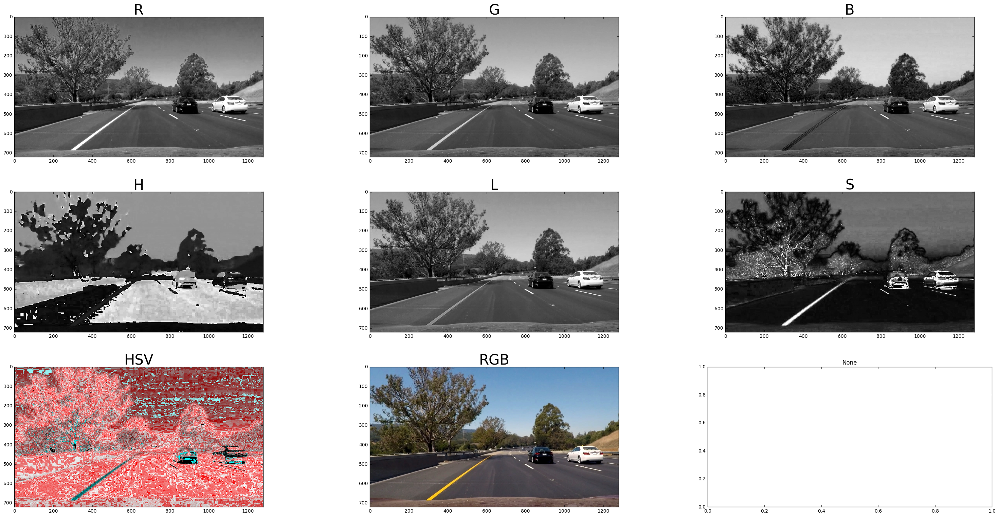

In [30]:
plot_all_color_channels(wrapped_lane_line_images[7])

It seems like the red, green, saturation, and lightness seem like good color channels to use for lane detection, now apply the different thresholds that can be used to detect lane lines.

The three thresholds that we can play with are:

1) Magnitude of the gradient

2) Angle of the gradient

3) The individual gradients in the x, and y directions

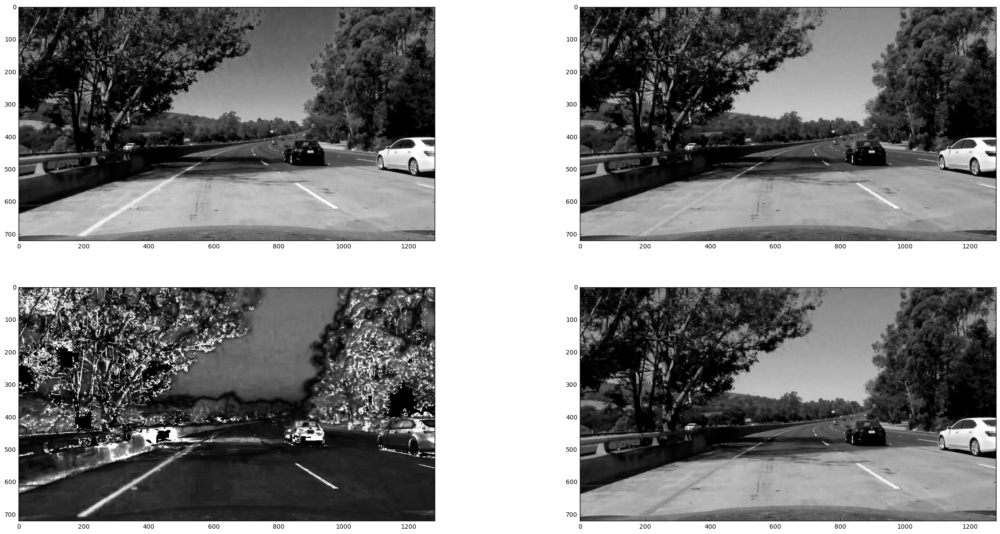

In [31]:
# First plot the R, G, and L channels
image_with_shadow = wrapped_lane_line_images[6]
dest_R = cv2.undistort(image_with_shadow.get_R(), mtx, dist, None, mtx)
dest_G = cv2.undistort(image_with_shadow.get_G(), mtx, dist, None, mtx)
dest_S = cv2.undistort(image_with_shadow.get_S(), mtx, dist, None, mtx)
dest_L = cv2.undistort(image_with_shadow.get_L(), mtx, dist, None, mtx)
f, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize = (30, 15))
ax1.imshow(dest_R, cmap = 'gray')
ax2.imshow(dest_G, cmap = 'gray')
ax3.imshow(dest_S, cmap = 'gray')
ax4.imshow(dest_L, cmap = 'gray')

In [32]:
# Define a sobel helper function
def sobel_calc(image, kernel_size):
    """
    This function takes an image of a single color channel, and returns a 2-tuple of images
    with the first element of the tuple being the Sobel operator on the x axis, and the second
    element being the Sobel operator on the y axis
    """
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize = kernel_size) 
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize = kernel_size)
    return((sobel_x), (sobel_y))

In [33]:
# Define a binary mask helper function
def binary_mask(image, threshold):
    """
    Takes in an image, and scales it to 0-255, then creates a binary image 
    where the active pixels are set according to the threshold
    
    :::params image: a (length x width) array (only 1 color channel)
              threshold: the numbers which determine the active pixels
    """
    # Get the absolute value of the pixels
    image = np.abs(image)
    
    # Scale to 0-255
    image = image * 255/np.max(image)
    binary_output = np.zeros_like(image)
    binary_output[(image >= threshold[0]) & (image <= threshold[1])] = 1
    return(binary_output)

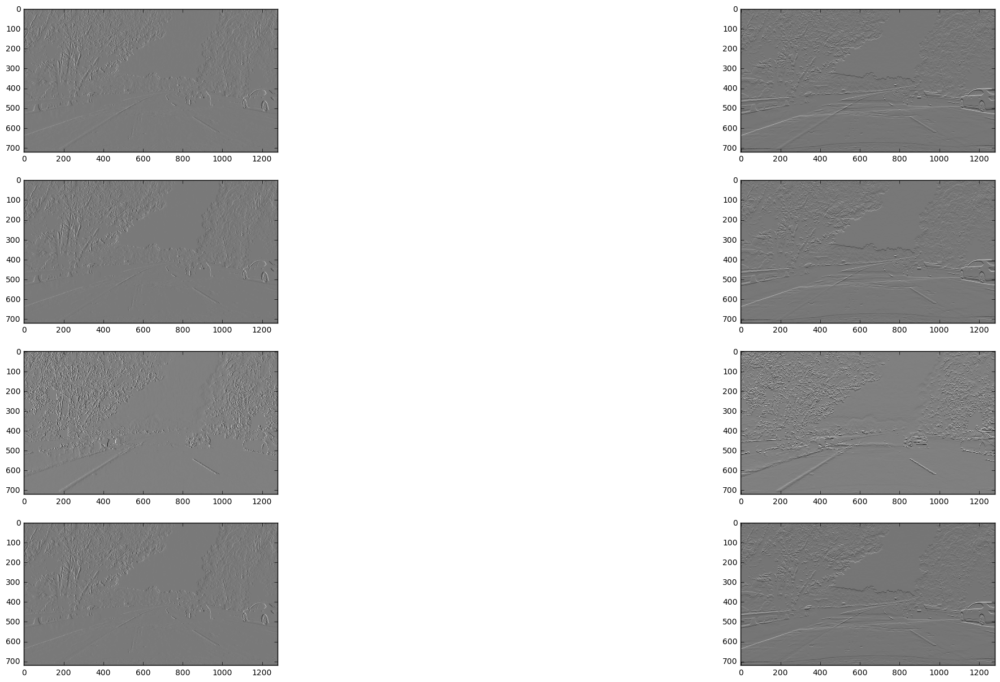

In [34]:
# Test the function
sobel_R = sobel_calc(dest_R, 3)
sobel_G = sobel_calc(dest_G, 3)
sobel_S = sobel_calc(dest_S, 3)
sobel_L = sobel_calc(dest_L, 3)
f, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8)) = plt.subplots(4, 2, figsize = (30, 15))
ax1.imshow(sobel_R[0], cmap = 'gray')
ax2.imshow(sobel_R[1], cmap = 'gray')
ax3.imshow(sobel_G[0], cmap = 'gray')
ax4.imshow(sobel_G[1], cmap = 'gray')
ax5.imshow(sobel_S[0], cmap = 'gray')
ax6.imshow(sobel_S[1], cmap = 'gray')
ax7.imshow(sobel_L[0], cmap = 'gray')
ax8.imshow(sobel_L[1], cmap = 'gray')

In [35]:
def magnitude_threshold(image, sobel_kernel = 3, mag_threshold = (0, 255)):
    """
    Takes in an image and returns a binary image dependent on the mag_threshold
    :::params image: a (length x width) array (only 1 color channel)
              sobel_kernel: the size of the sobel kernel
              mag_threshold: the max and min magnitudes which determines which pixels are active
    """
    # Get the x, y sobels
    image_sobel = sobel_calc(image, sobel_kernel)
    sobel_x = image_sobel[0]
    sobel_y = image_sobel[1]
    
    # Find the magnitude 
    mag = np.sqrt(np.square(sobel_x) + np.square(sobel_y))
    
    # Get a binary mask of the magnitude
    binary_output = binary_mask(mag, mag_threshold)
    
    return(binary_output)



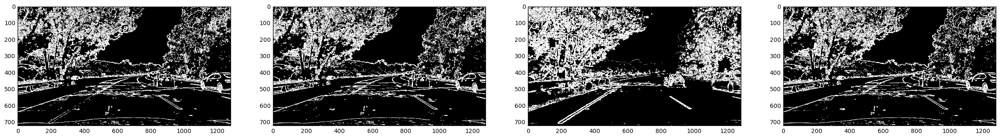

In [36]:
threshold = (20, 255)
mag_R = magnitude_threshold(dest_R, mag_threshold = threshold)
mag_G = magnitude_threshold(dest_G, mag_threshold = threshold)
mag_S = magnitude_threshold(dest_S, mag_threshold = threshold)
mag_L = magnitude_threshold(dest_L, mag_threshold = threshold)
f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize = (30, 15))
ax1.imshow(mag_R, cmap = 'gray')
ax2.imshow(mag_G, cmap = 'gray')
ax3.imshow(mag_S, cmap = 'gray')
ax4.imshow(mag_L, cmap = 'gray')

In [37]:
def axis_threshold(image, axis, sobel_kernel = 3, sobel_threshold = (0, 255)):
    """
    Takes in an image and returns a binary image dependent on the mag_threshold
    :::params image: a (length x width) array (only 1 color channel)
              axis: the direction to apply the sobel operator, 0 is x, 1 is y
              sobel_kernel: the size of the sobel kernel
              sobel_threshold: the max and min sobel values which determines which pixels are active
    """
    image_sobel = sobel_calc(image, sobel_kernel)
    sobel_x = image_sobel[0]
    sobel_y = image_sobel[1]
    if (axis == 0):
        binary_output = binary_mask(sobel_x, sobel_threshold)
    else:
        binary_output = binary_mask(sobel_y, sobel_threshold)
    
    return(binary_output)

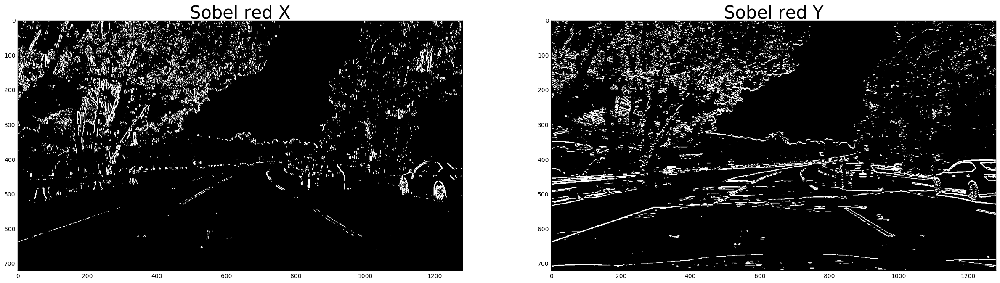

In [38]:
# Plot the output of axis_threshold
threshold = (30, 255)
font = {'size' : 30}
sobel_x_R = axis_threshold(dest_R, 0, sobel_threshold = threshold)
sobel_y_R = axis_threshold(dest_R, 1, sobel_threshold = threshold)
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (30, 15))
ax1.imshow(sobel_x_R, cmap = 'gray')
ax1.set_title("Sobel red X", fontdict = font)
ax2.imshow(sobel_y_R, cmap = 'gray')
ax2.set_title("Sobel red Y", fontdict = font)

In [39]:
def angle_threshold(image, sobel_kernel = 3, angle_threshold = (0, np.pi/2)):
    """
    Takes in an image and returns a binary image dependent on the mag_threshold
    :::params image: a (length x width) array (only 1 color channel)
              sobel_kernel: the size of the sobel kernel
              angle_threshold: the max and min angles which determines which pixels are active
    """
    # Apply sobel operator on the image
    image_sobel = sobel_calc(image, sobel_kernel)
    sobel_x = image_sobel[0]
    sobel_y = image_sobel[1]
    
    # 3) Take the absolute value of the x and y gradients
    abs_sobel_x = np.absolute(sobel_x)
    abs_sobel_y = np.absolute(sobel_y)
    
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    angle = np.arctan2(abs_sobel_y, abs_sobel_x)
    
    # 5) Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(angle)
    binary_output[(angle >= angle_threshold[0]) & (angle <= angle_threshold[1])] = 1
    return(binary_output)

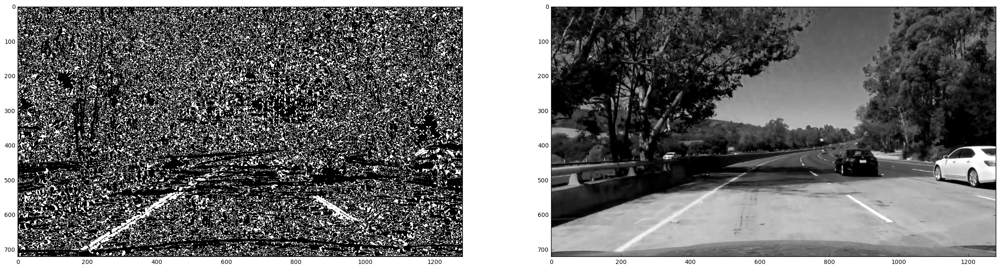

In [40]:
threshold = (0.7, 1.2)
angle_R = angle_threshold(dest_R, sobel_kernel = 11, angle_threshold = threshold)
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (30, 15))

ax1.imshow(angle_R, cmap = 'gray')
ax2.imshow(dest_R, cmap = 'gray')


In [41]:
def get_undistorted_images(image):
    dest_R = cv2.undistort(image.get_R(), mtx, dist, None, mtx)
    dest_G = cv2.undistort(image.get_G(), mtx, dist, None, mtx)
    dest_S = cv2.undistort(image.get_S(), mtx, dist, None, mtx)
    dest_L = cv2.undistort(image.get_L(), mtx, dist, None, mtx) 
    return([dest_R, dest_G, dest_S, dest_L])

In [42]:
import matplotlib.gridspec as gridspec
def plot_thresholds(images):
    """
    This function plots the data using the output of get_data_in_bin
    
    params data: this is a list of data frame rows, one from each bin
    
    """
    
    # Define spacing between the plots
    fig = plt.figure(figsize=(30, 15))
    gs = gridspec.GridSpec(1,4)
    color_channels = ["R", "G", "S", "L"]
   
    # loop through the 
    for i in range(len(images)):
        ax = fig.add_subplot(gs[i])
        
        # If we have a row from the data frame, then we need to extract 
        # the raw data 
        ax.imshow(images[i], cmap = 'gray')
        ax.set_title(color_channels[i], fontdict = {'size' :30})
    gs.tight_layout(fig)
    plt.show()

In [43]:
# Define the thresholds to be used`
sobel_threshold = (10, 255)
mag_threshold = (10, 255)
ang_threshold = (0.7, 1.2)

# Tune these thresholds on the image that have the hardest lane line to recognize

undistorted_images = get_undistorted_images(image_with_shadow)
axis_x_thresholded_images = [axis_threshold(image, 0, sobel_threshold = sobel_threshold) for image in undistorted_images]
axis_y_thresholded_images = [axis_threshold(image, 1, sobel_threshold = sobel_threshold) for image in undistorted_images]
magnitude_thresholded_images = [magnitude_threshold(image, mag_threshold = mag_threshold) for image in undistorted_images]
angle_thresholded_images = [angle_threshold(image, sobel_kernel = 15, angle_threshold = ang_threshold) for image in undistorted_images]

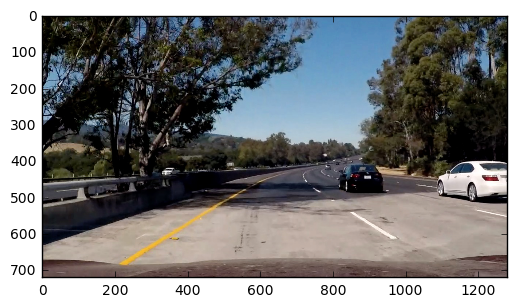

In [44]:
plt.imshow(image_with_shadow.get_RGB())

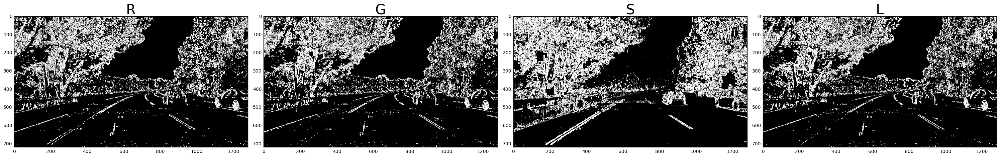

In [45]:
plot_thresholds(axis_x_thresholded_images)

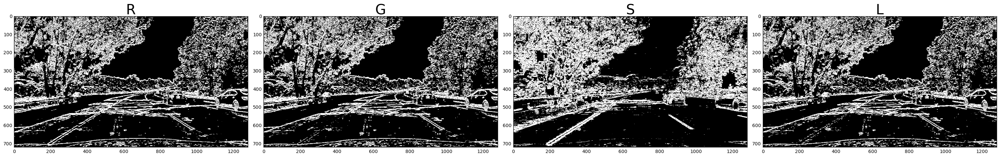

In [46]:
plot_thresholds(axis_y_thresholded_images)

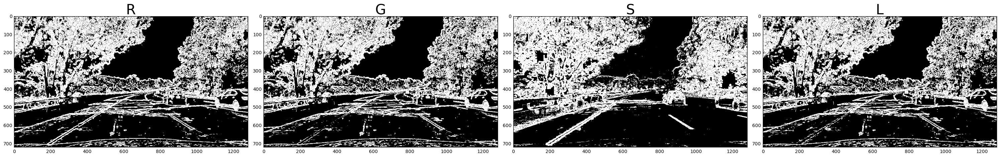

In [47]:
plot_thresholds(magnitude_thresholded_images)

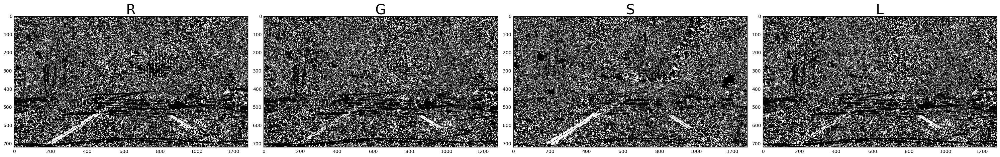

In [48]:
plot_thresholds(angle_thresholded_images)

In [98]:
def stack_images(*images, k_size = 5): 
    """
    Takes an arbitrary amount of binary masked images, and stacks them ontop of
    each other
    """
    stacked_image = np.zeros_like(images)[0]
    for image in images:
        stacked_image[(image == 1)] += 1
   
    blur = cv2.GaussianBlur(stacked_image,(k_size, k_size),0)
    
    binary_output = np.zeros_like(blur)
    binary_output[blur >= (np.max(blur)/2)] = 1
#     stacked_image[stacked_image <= len(images)/2] = 0
#     stacked_image[stacked_image > len(images)/2] = 1
#     return(stacked_image)
    return(binary_output) 

In [167]:
s_size = 5
axis_x_thresholded_images = [axis_threshold(image, 0, sobel_kernel = s_size, sobel_threshold = sobel_threshold) for image in undistorted_images]
axis_y_thresholded_images = [axis_threshold(image, 1, sobel_kernel = s_size, sobel_threshold = sobel_threshold) for image in undistorted_images]
magnitude_thresholded_images = [magnitude_threshold(image, mag_threshold = mag_threshold) for image in undistorted_images]
angle_thresholded_images = [angle_threshold(image, sobel_kernel = 15, angle_threshold = ang_threshold) for image in undistorted_images]
images = [axis_x_thresholded_images[0], axis_x_thresholded_images[1], \
          axis_x_thresholded_images[2], axis_x_thresholded_images[3], \
          magnitude_thresholded_images[2], angle_thresholded_images[2]]
# images = [binary_mask(image, threshold) for image in images]
stacked_image = stack_images(*images, k_size = 11)

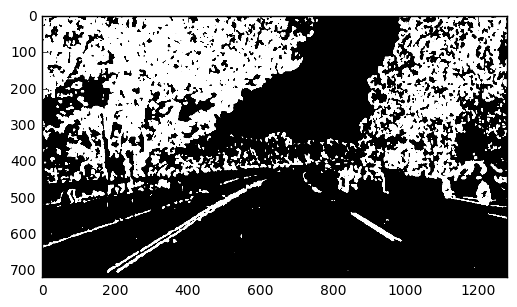

In [168]:
plt.imshow(stacked_image, cmap = 'gray')
# plt.imshow(axis_y_thresholded_images[2], cmap = 'gray')

# Perspective transform to show road from bird's eye view

In [205]:
top_right_src = [760, 460]
top_left_src = [570, 460]
bottom_right_src = [1050, 650]
bottom_left_src = [240, 650]

# Stretch it into a square
top_right_dest = [870, 100]
top_left_dest = [240, 100]
bottom_right_dest = [870, 650]
bottom_left_dest = [240, 650]
# src coordinates
src = np.float32([
    top_right_src, # top right
    bottom_right_src, # bottom right
    bottom_left_src, # bottom left
    top_left_src # top left
])

# dest coordinates
dst = np.float32([
    top_right_dest, # top right
    bottom_right_dest, # bottom right
    bottom_left_dest, # bottom left
    top_left_dest # top left
])

def warper(image, src, dst):
    M = cv2.getPerspectiveTransform(src, dst)
    image_size = (image.shape[1], image.shape[0])
    warped = cv2.warpPerspective(image, M, image_size, flags=cv2.INTER_LINEAR) 
    return(warped)

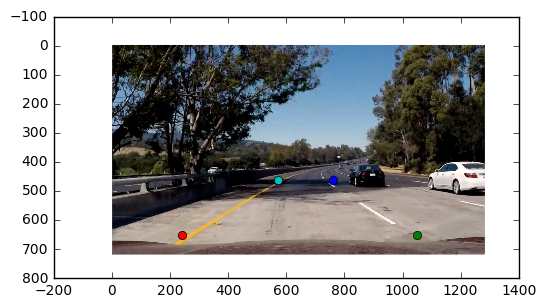

In [206]:
image = image_with_shadow.get_RGB()
plt.imshow(image)
plt.plot(src[0][0], src[0][1], 'o')
plt.plot(src[1][0], src[1][1], 'o')
plt.plot(src[2][0], src[2][1], 'o')
plt.plot(src[3][0], src[3][1], 'o')
plt.show()

[[[ 47  53  75]
  [ 38  44  56]
  [ 33  38  41]
  ..., 
  [ 76  94  80]
  [102 120 103]
  [145 160 142]]

 [[ 40  45  64]
  [ 27  34  45]
  [ 19  25  23]
  ..., 
  [  9  27  15]
  [ 21  39  23]
  [ 89 104  88]]

 [[ 35  41  53]
  [ 23  29  33]
  [ 19  24  16]
  ..., 
  [ 19  37  25]
  [  7  23  10]
  [ 14  29  13]]

 ..., 
 [[ 31  37  41]
  [ 52  51  55]
  [ 96  88  91]
  ..., 
  [121 106 103]
  [121 106 103]
  [124 109 106]]

 [[ 42  48  52]
  [ 29  30  35]
  [ 66  60  64]
  ..., 
  [130 115 112]
  [131 116 113]
  [135 120 117]]

 [[ 47  53  59]
  [ 36  37  42]
  [ 37  31  35]
  ..., 
  [137 122 119]
  [138 123 120]
  [141 126 123]]]


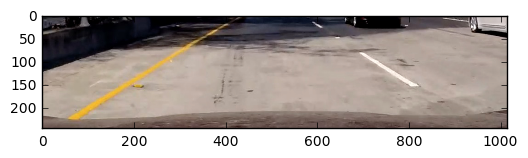

In [362]:
plt.imshow(image[460:705,155:1170])
print(image)

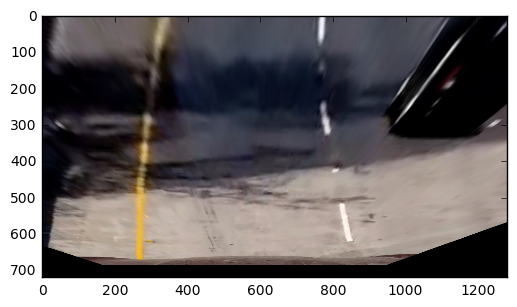

In [361]:
plt.imshow(warper(image, src, dst))

In [328]:
warped = warper(stacked_image, src, dst)
binary_warped = np.zeros_like(binary_warped)
binary_warped[warped > 0.5] = 1

(720, 1280)

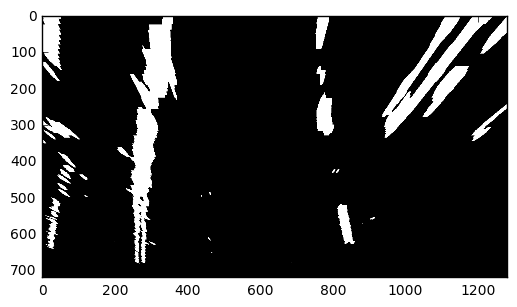

In [380]:
plt.imshow(binary_warped, cmap = 'gray')
binary_warped.shape

/Users/kevinlu/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel/__main__.py:2: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  from ipykernel import kernelapp as app


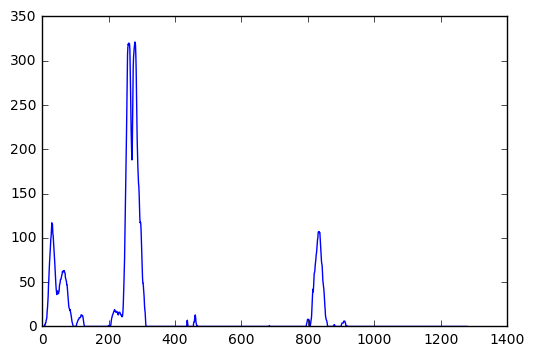

In [381]:
# Get the histogram of the pixel values for the bottom half of the image
hist = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis = 0)
plt.plot(hist)

(720, 1280, 3)
[[[ 100.  100.  100.]
  [ 100.  100.  100.]
  [ 100.  100.  100.]
  ..., 
  [   0.    0.    0.]
  [   0.    0.    0.]
  [ 100.  100.  100.]]]


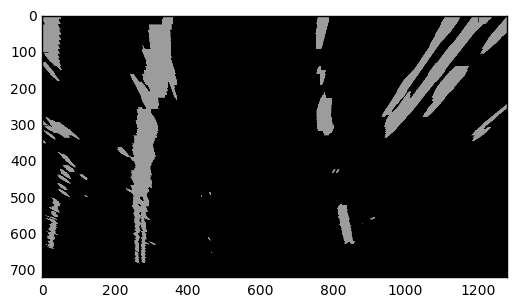

In [394]:
out_image = np.dstack((binary_warped, binary_warped, binary_warped)) * 100
print(out_image.shape)
print(out_image[0:1])
plt.imshow(out_image)

In [365]:
# Find the base of the lines
midpoint = np.int(hist.shape[0]/2)
base_left_x = np.argmax(hist[:midpoint])
base_right_x = np.argmax(hist[midpoint:]) + midpoint

In [366]:
# Get the height for the sliding window
n_windows = 9
window_height = np.int(binary_warped.shape[0]/n_windows)

In [367]:
# Identify the x and y positions of all non-zero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])

In [368]:
# Current positions
current_left_x = base_left_x
current_right_x = base_right_x

In [369]:
# Set the width of the windows
width = 100

# Set the minimum number of pixels found to recenter the window
minpix = 50

# Create empty lists to receive the left and right lane pixel indcies
left_lane_idx = []
right_lane_idx = []

In [370]:
# Step through the windows one by one
for window in range(n_windows):
    # Height for the windows
    win_y_low = binary_warped.shape[0] - (window + 1) * window_height
    win_y_high = binary_warped.shape[0] - window * window_height
    
    # starting and ending x coordinates of the window for the left lane line
    win_x_left_low = current_left_x - width
    win_x_left_high = current_left_x + width
    
    # starting and ending x coordinates of the window for the right lane line
    win_x_right_low = current_right_x - width
    win_x_right_high = current_right_x + width
    cv2.rectangle(out_image, (win_x_left_low, win_y_low), (win_x_left_high, win_y_high), (0, 255, 0), 2)
    cv2.rectangle(out_image,(win_x_right_low,win_y_low),(win_x_right_high,win_y_high),(0,255,0), 2) 

    # Identify the indexes of nonzero pixels in x and y within the window
    good_left_idx = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & \
                     (nonzerox >= win_x_left_low) & (nonzerox < win_x_left_high)).nonzero()[0]
    good_right_idx = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & \
                      (nonzerox >= win_x_right_low) & (nonzerox < win_x_right_high)).nonzero()[0]
    
#     print(good_left_idx)
#     print(good_right_idx)
    
    # Append these indices to the lists
    left_lane_idx.append(good_left_idx)
    right_lane_idx.append(good_right_idx)
    
    if len(good_left_idx) > minpix:
        current_left_x = np.int(np.mean(nonzerox[good_left_idx]))
    if len(good_right_idx) > minpix:
        current_right_x = np.int(np.mean(nonzerox[good_right_idx]))

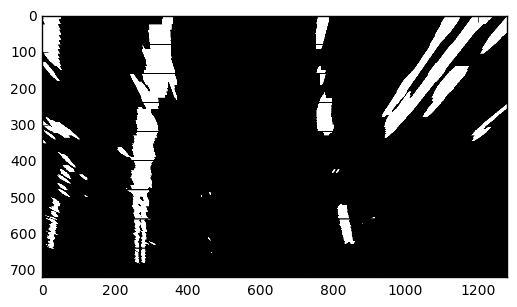

In [371]:
plt.imshow(out_image)

In [372]:
# Concatenate the arrays of indices
left_lane_idx = np.concatenate(left_lane_idx)
right_lane_idx = np.concatenate(right_lane_idx)

# Extract left and right line pixel positions
left_x = nonzerox[left_lane_idx]
left_y = nonzeroy[left_lane_idx] 
right_x = nonzerox[right_lane_idx]
right_y = nonzeroy[right_lane_idx] 

# Fit a second order polynomial to each
left_fit = np.polyfit(left_y, left_x, 2)
right_fit = np.polyfit(right_y, right_x, 2)

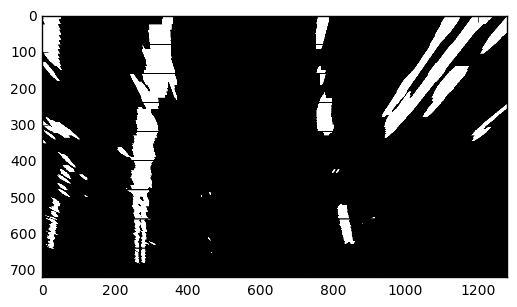

In [373]:
plt.imshow(out_image)

(720, 0)

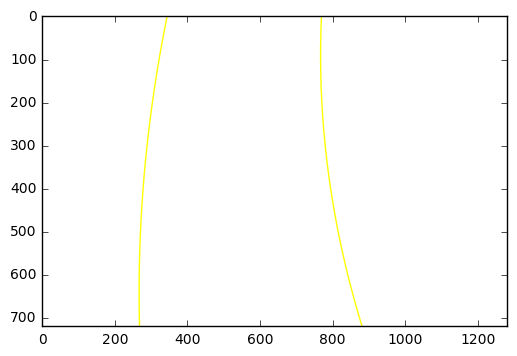

In [374]:
# Visualize the results
plot_y = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
left_fit_x = left_fit[0] * plot_y ** 2 + left_fit[1] * plot_y + left_fit[2]
right_fit_x = right_fit[0] * plot_y ** 2 + right_fit[1] * plot_y + right_fit[2]

out_image[nonzeroy[left_lane_idx], nonzerox[left_lane_idx]] = [255, 0, 0]
out_image[nonzeroy[right_lane_idx], nonzerox[right_lane_idx]] = [0, 0 ,255]
plt.plot(left_fit_x, plot_y, color='yellow')
plt.plot(right_fit_x, plot_y, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)